# Исследование рынка заведений общественного питания Москвы

## Предобработка данных

### Общая информация

In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
from folium.plugins import MarkerCluster
from folium import Map, Marker, Choropleth

Посмотрим на содержание файла и тип данных:

In [2]:
pth1 = '...'
pth2 = '...'

if os.path.exists(pth1):
    data = pd.read_csv(pth1)
elif os.path.exists(pth2):
    data = pd.read_csv(pth2)
else:
    print('Проверьте путь к файлу')

In [3]:
# вывод первых 5 строк
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


Описание столбцов:

...

In [4]:
# просмотр количества заполненных строк в столбцах и типов данных 
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [5]:
# считаем количество уникальных наименований заведений
data['name'].nunique()

5614

В датасете представлена информация о 8406 заведениях. Из них уникальных названий 5614.

По типу данных столбцы разделяются на строковые и числовые. 

Поменяем тип данных в столбце `chain` с числового на строковое, потому что столбец содержит только значения 0 и 1 и отвечает на вопрос, является ли заведение сетевым. Заполним словом "Да" ячейки, в которых стоит 1, и словом "Нет", если в ячейке 0:

In [6]:
# уникальные значения в столбце
data['chain'].unique()

array([0, 1])

In [7]:
# смена типа данных и заполнение значениями
data['chain'] = np.where(data['chain'] == 1, 'Да', 'Нет')

Типы данных в остальных столбцах соответствуют содержанию.

### Анализ пропусков

In [8]:
# подсчет пропусков в процентах от общего числа строк

pd.DataFrame((data.isna().mean()*100).round(0)).style.background_gradient('OrRd')

,0
name,0.000000
category,0.000000
address,0.000000
district,0.000000
hours,6.000000
lat,0.000000
lng,0.000000
rating,0.000000
price,61.000000
avg_bill,55.000000


Столбец `price` с категориями цен будет участвовать в исследовании, он имеет строковый тип данных, поэтому заполним пропуски заглушками "unknown", чтобы не упустить данные при анализе.

In [9]:
# смотрим уникальные значения в столбце 'price' и тип данных
data['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

In [10]:
# заполняем пропуски
data['price'] = data['price'].fillna('unknown')
# проверка заполнения
data['price'].isna().sum()

0

Также пропуски есть в режиме работы некоторых заведений (6%), среднем чеке (51%) и средней цене чашки кофе (94%), а также количестве посадочных мест (43%). 

Но заполнить пропуски нам нечем, лучше оставим их как есть и будем производить расчеты из имеющихся данных.

Наше исследование будет использоваться для определения лучшего местоположения нового заведения, поэтому основные данные для такого анализа у нас есть в полном объеме: район расположения, адрес, координаты, наименование заведения, его рейтинг, принадлежность к сети заведений.

###  Проверка на дубликаты

Проверим данные на дубликаты:

In [11]:
data.duplicated().sum()

0

Полных строк-дубликатов не найдено. 

Приведем названия заведений к нижнему регистру и проверим неявные дубликаты:

In [12]:
# количество уникальных названий заведений в датасете до изменений
data['name'].nunique()

5614

In [13]:
# приведем к нижнему регистру названия заведений 
# и после этого еще раз посчитаем количество уникальных наименований
data['name'] = data['name'].str.lower()
data['name'].nunique()

5512

Было найдено 102 дубликата - наименования. 

Проверим строки-дубликаты по измененным названиям заведений и адресу:

In [14]:
data.duplicated(subset=['name', 'address']).sum()

3

In [15]:
# удалим найденные строки-дубликаты 
data = data.drop_duplicates(subset=['name', 'address']).reset_index(drop=True)
# проверка удаления
data.duplicated(subset=['name', 'address']).sum()

0

Поищем дубликаты в названиях категорий заведений и наименованиях административных округов, просмотрев уникальные названия, т.к. их немного:

In [16]:
#выведем все уникальные названия категорий
data['category'].value_counts()

кафе               2377
ресторан           2042
кофейня            1413
бар,паб             764
пиццерия            633
быстрое питание     603
столовая            315
булочная            256
Name: category, dtype: int64

In [17]:
#выведем все уникальные названия округов
data['district'].value_counts()

Центральный административный округ         2242
Северный административный округ             899
Южный административный округ                892
Северо-Восточный административный округ     890
Западный административный округ             850
Восточный административный округ            798
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Северо-Западный административный округ      409
Name: district, dtype: int64

Дублирование наименований не обнаружено.

###  Дополнительные столбцы

Создадим столбец `street` с названиями улиц из столбца с адресом:

In [18]:
data['street'] = data['address'].str.split(', ').str[1]

Создадим столбец `is_24/7` с обозначением того, работает ли заведение ежедневно и круглосуточно (24/7):
  
    логическое значение True — если заведение работает ежедневно и круглосуточно;
    логическое значение False — в противоположном случае.

In [19]:
# посмотрим, какие значения может содержать столбец hours
data['hours'].unique()

array(['ежедневно, 10:00–22:00',
       'пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00–02:00',
       'ежедневно, 09:00–22:00', ...,
       'пн-пт 08:30–21:30; сб,вс 09:00–21:30',
       'пн-чт 13:00–22:00; пт,сб 13:00–22:30; вс 13:00–22:00',
       'пн-сб 10:30–21:30'], dtype=object)

In [20]:
data['is_24/7'] = np.where(data['hours']\
                           .isin(['ежедневно, круглосуточно']), True, False)

In [21]:
# проверка новых столбцов
data.head(2)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,unknown,NaN,NaN,NaN,Нет,NaN,улица Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,Нет,4.0,улица Дыбенко,False


## Анализ данных

### Категории заведений

Посмотрим, какие категории заведений представлены в данных, и сколько объектов относится к каждой категории:

In [22]:
category = data.pivot_table(index='category', values='name', aggfunc='count')\
.sort_values(by='name', ascending=False).reset_index()
category

,category,name
0,кафе,2377
1,ресторан,2042
2,кофейня,1413
3,"бар,паб",764
4,пиццерия,633
5,быстрое питание,603
6,столовая,315
7,булочная,256


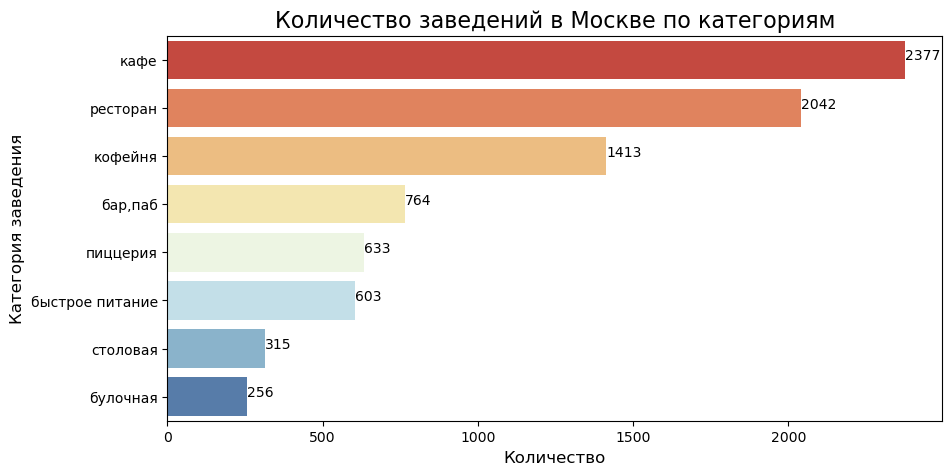

In [23]:
# построим столбчатую диаграмму
plt.figure(figsize=(10, 5))
sns.barplot(x='name', y='category', data= category, palette='RdYlBu')
plt.title('Количество заведений в Москве по категориям', size=16)
plt.xticks(size=10)
plt.yticks(size=10)
plt.xlabel('Количество', size=12)
plt.ylabel('Категория заведения', size=12)

for index, value in enumerate(category['name']):
    plt.text(value, index,
             str(value))
plt.show()

In [24]:
# построим круговую диаграмму
fig = px.pie(category, values='name', names='category', \
             color_discrete_sequence=px.colors.sequential.RdBu,  \
             title='Принадлежность заведений к категории')
fig.show()

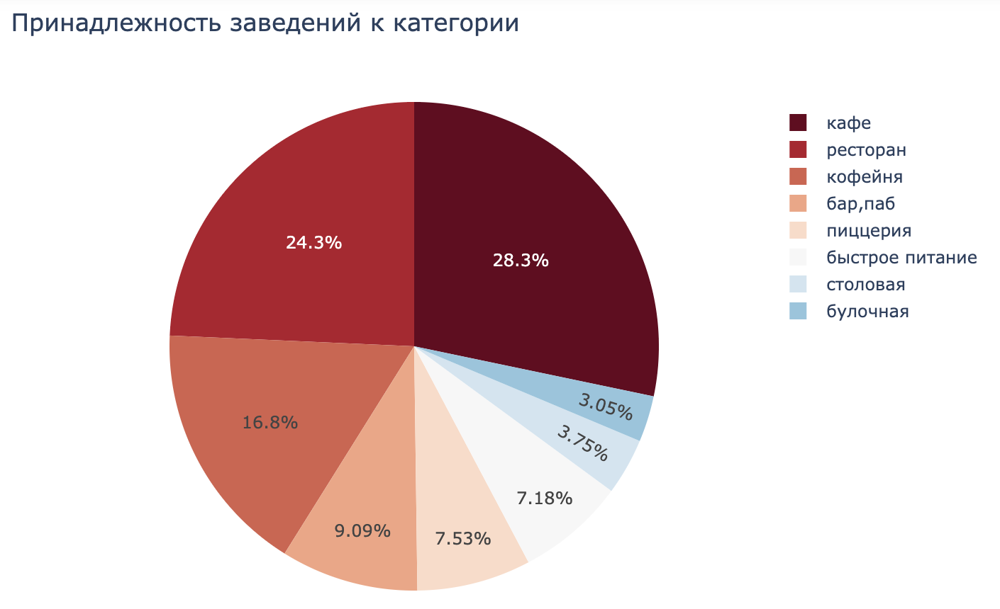

Мы видим, что большая часть заведений Москвы позиционирует себя как кафе, далее идут рестораны и кофейни. Меньше всего в городе булочных и столовых.

### Посадочные места

Посмотрим на распределение количества посадочных мест по категориям заведений:

In [25]:
# отсортируем категории по убыванию медианы посадочных мест
seats_medians = data.groupby('category', as_index=False)['seats']\
.median().sort_values(by='seats', ascending=False)

seats_medians

,category,seats
6,ресторан,86.0
0,"бар,паб",82.0
4,кофейня,80.0
7,столовая,75.5
2,быстрое питание,65.0
3,кафе,60.0
5,пиццерия,55.0
1,булочная,50.0


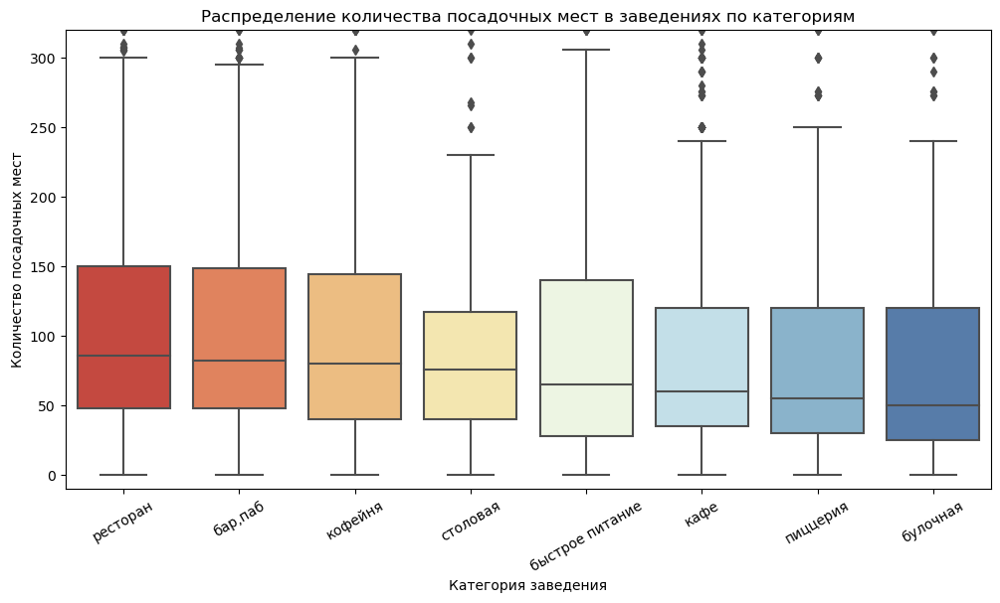

In [26]:
# построим boxplot
plt.figure(figsize=(12, 6))
sns.boxplot(x='category', y='seats', data=data, order=seats_medians['category'], palette='RdYlBu') 
plt.ylim(-10, 320)
plt.title('Распределение количества посадочных мест в заведениях по категориям')
plt.xticks(rotation=30)
plt.xlabel('Категория заведения')
plt.ylabel('Количество посадочных мест');

Мы видим, что почти все заведения имеют примерно до 300 посадочных мест, а большинство из них (75%) до 150 мест. Посмотрим, какие данные (заведения) у нас попадают в выбросы:

In [27]:
# смотрим заведения с более чем 300 посадочными местами
data.query('seats > 300')['name'].value_counts()

шоколадница               5
french bakery             4
vasilchukí chaihona №1    4
one price coffee          3
prime                     3
                         ..
bakery                    1
кафе                      1
495                       1
paradise                  1
султан палас              1
Name: name, Length: 226, dtype: int64

Судя по названиям, это реальные объекты, крупные известные сети кафе и ресторанов, не будем исключать эти данные из анализа, а возьмем медианное количество посадочных мест в качестве среднего, чтобы выбросы не сильно влияли на результат.

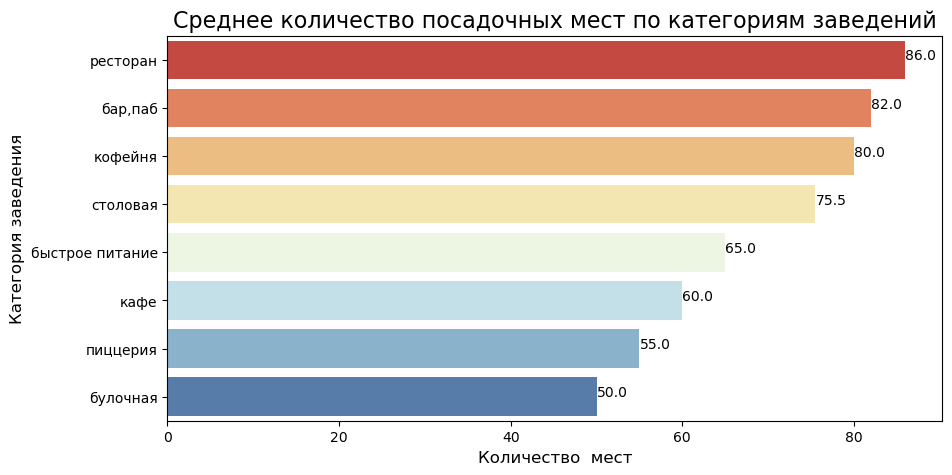

In [28]:
# построим столбчатую диаграмму
plt.figure(figsize=(10, 5))
sns.barplot(x='seats', y='category', data= seats_medians, palette='RdYlBu')
plt.title('Среднее количество посадочных мест по категориям заведений', size=16)
plt.xticks(size=10)
plt.yticks(size=10)
plt.xlabel('Количество  мест', size=12)
plt.ylabel('Категория заведения', size=12)

for index, value in enumerate(seats_medians['seats']):
    plt.text(value, index,
             str(value))
    
plt.show()

Мы видим, что рестораны, бары, пабы и кофейни в среднем имеют больше всего посадочных мест (от 80 и более), а соответственно, и больше площадь заведений.

В среднюю категорию (от 60 до 80 мест) попадают столовые, объекты быстрого питания и кафе.

И узконаправленные заведения, такие как пиццерия и булочные имеют меньше всего мест в среднем (менее 60).

### Сетевое/ несетевое заведение

**Посмотрим на количество сетевых и несетевых заведений** и построим диаграмму для наглядности.

In [29]:
chain_all = data.groupby('chain', as_index=False)['name'].count()
chain_all

,chain,name
0,Да,3203
1,Нет,5200


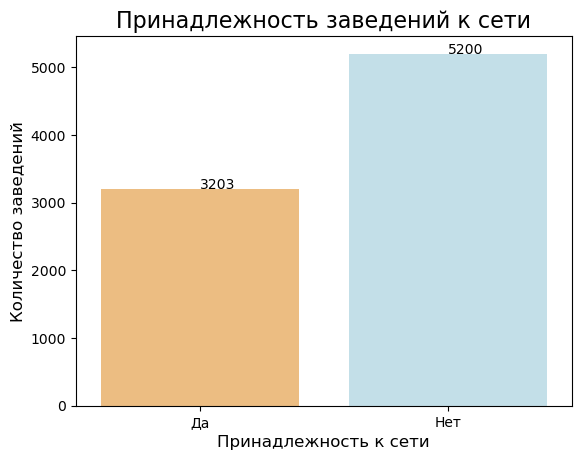

In [30]:
sns.barplot(x='chain', y='name', data=chain_all, palette='RdYlBu')
plt.title('Принадлежность заведений к сети', size=16)
plt.xticks(size=10)
plt.yticks(size=10)
plt.xlabel('Принадлежность к сети', size=12)
plt.ylabel('Количество заведений', size=12)

for index, value in enumerate(chain_all['name']):
    plt.text(index, value,
             str(value))
    
plt.show()

In [31]:
# Рассчитаем соотношение несетевых заведений к сетевым
round(chain_all.loc[1, 'name'] / chain_all.loc[0, 'name'], 2)

1.62

Несетевых заведений в 1.6 раза больше, чем сетевых. 

**Проанализируем принадлежность заведений к сети в разрезе категорий**, построим сводную таблицу и диаграмму:

In [32]:
# строим сводную таблицу по категориях и принадлежности к сети
chain_categ = data.pivot_table(index=['category', 'chain'], values='name', \
                               aggfunc='count').reset_index()\
.sort_values(by=['category', 'name'], ascending=False)
chain_categ

,category,chain,name
15,столовая,Нет,227
14,столовая,Да,88
13,ресторан,Нет,1313
12,ресторан,Да,729
10,пиццерия,Да,330
11,пиццерия,Нет,303
8,кофейня,Да,720
9,кофейня,Нет,693
7,кафе,Нет,1598
6,кафе,Да,779


In [33]:
# строим сводную таблицу по категориях и принадлежности к сети
chain_categ = data.pivot_table(index=['category', 'chain'], values='name', \
                               aggfunc='count').reset_index()\
.sort_values(by='name', ascending=False)
chain_categ

,category,chain,name
7,кафе,Нет,1598
13,ресторан,Нет,1313
6,кафе,Да,779
12,ресторан,Да,729
8,кофейня,Да,720
9,кофейня,Нет,693
1,"бар,паб",Нет,596
5,быстрое питание,Нет,371
10,пиццерия,Да,330
11,пиццерия,Нет,303


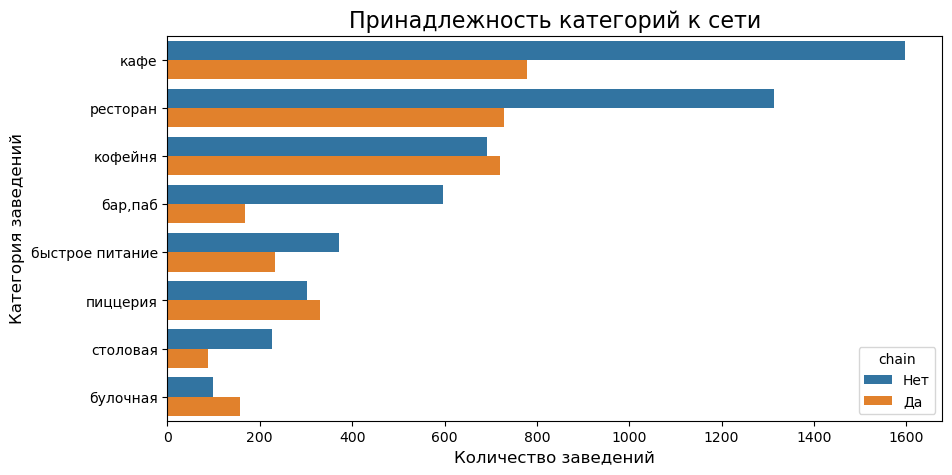

In [34]:
# диаграмма
plt.figure(figsize=(10, 5))
sns.barplot(x='name', y='category', data=chain_categ, hue='chain')
plt.title('Принадлежность категорий к сети', size=16)
plt.xticks(size=10)
plt.yticks(size=10)
plt.xlabel( 'Количество заведений', size=12)
plt.ylabel('Категория заведений', size=12)
plt.show()

В количественном выражении в городе больше всего несетевых кафе и ресторанов. 

Если рассматривать каждую категорию, то мы видим, что в большинстве категорий количественно преобладают несетевые заведения над сетевыми. 

Такие категории как кофейни и пиццерии представлены примерно равными долями сетевых/несетевых объектов, а среди булочных, наоборот, преобладают сетевые заведения.

### Топ-15 популярных сетей в Москве

Найдем 15 самых популярных сетевых заведений Москвы. Под популярностью понимается количество заведений этой сети. Построим диаграмму с количеством заведений в каждой сети.

In [35]:
# сводная таблица по количеству заведений в каждой сети
chain_top_15 = (data
 .query('chain == "Да"')
 .pivot_table(index='name', values='address', aggfunc='count')
 .sort_values(by='address', ascending=False)
 .reset_index()
 .head(15)
)
chain_top_15 = chain_top_15.rename(columns={'address': 'object_count'})
chain_top_15

,name,object_count
0,шоколадница,120
1,домино'с пицца,76
2,додо пицца,74
3,one price coffee,71
4,яндекс лавка,69
5,cofix,65
6,prime,50
7,хинкальная,44
8,кофепорт,42
9,кулинарная лавка братьев караваевых,39


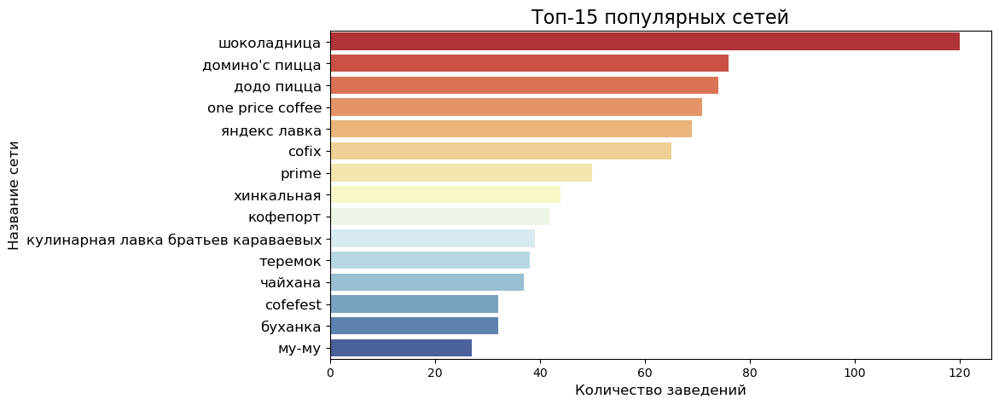

In [36]:
# диаграмма
plt.figure(figsize=(10, 5))
sns.barplot(x='object_count', y='name', data=chain_top_15, palette='RdYlBu')
plt.title('Топ-15 популярных сетей', size=16)
plt.xticks(size=10)
plt.yticks(size=12)
plt.xlabel( 'Количество заведений', size=12)
plt.ylabel('Название сети', size=12)
plt.show()

"Шоколадница" имеет значительно больше заведений в Москве, чем остальные сети. 

Посмотрим, к каким категориям относятся представленные в сети заведения.

In [37]:
# сводная таблица топ-15 с разбивкой на категории
chain_top_categ = (data[data['name'].isin(chain_top_15['name'])]
                   .pivot_table(index=['name', 'category'], values='address', aggfunc='count')
                   .sort_values(by='name')
                   .reset_index()
)
chain_top_categ = chain_top_categ.rename(columns={'address': 'object_count'})

# диаграмма в разрезе категорий
fig=px.bar(chain_top_categ, x='object_count', y='name', color='category', text='object_count')
fig.update_layout(
    title='Топ-15 популярных сетей с разбивкой по категориям', 
    xaxis_title='Количество заведений', 
    yaxis_title='Название сети',
    yaxis={'categoryorder': 'total ascending'}
    )
fig.show()

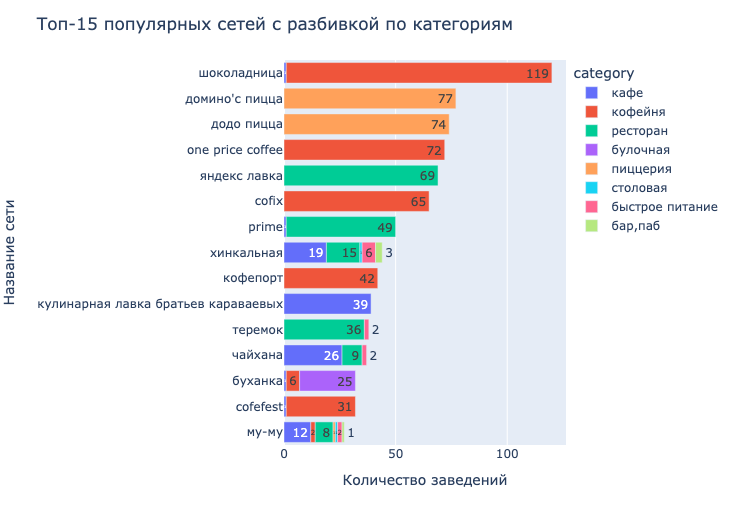

In [38]:
chain_top_categ.head()

,name,category,object_count
0,cofefest,кафе,1
1,cofefest,кофейня,31
2,cofix,кофейня,65
3,one price coffee,кофейня,72
4,prime,кафе,1


Популярные сети представлены преимущественно кофейнями, пиццериями, ресторанами и просто кафе.

Объединяет эти сети, возможно, невысокая и средняя ценовая категория. Проверим эту гипотезу, для этого посмотрим, какие ценовые категории предсталены в заведениях топ-15. Построим сводную таблицу по количеству "представителей" каждой ценовой категории и построим круговую диаграмму:

In [39]:
top_15_price = (data[data['name'].isin(chain_top_15['name'])]
                .groupby('price', as_index=False)['name'].count()
                .sort_values(by='name', ascending=False)
               )
top_15_price

,price,name
0,unknown,576
4,средние,211
3,низкие,23
2,выше среднего,6
1,высокие,2


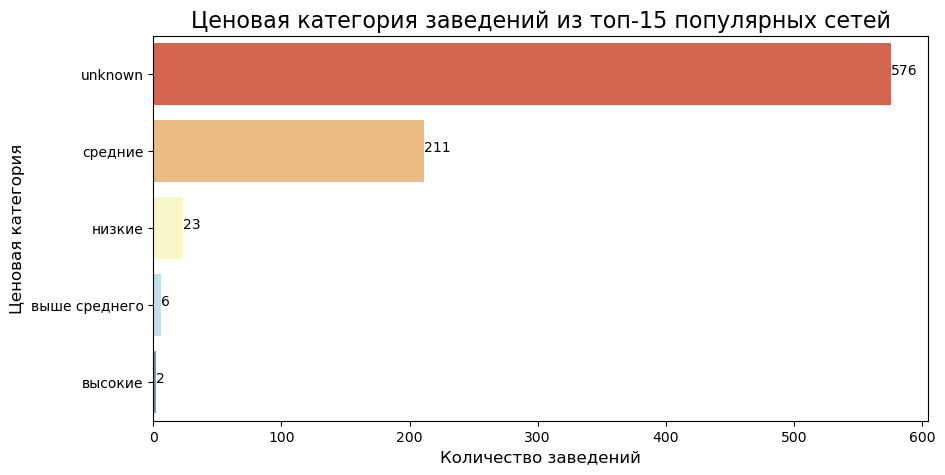

In [40]:
plt.figure(figsize=(10, 5))
sns.barplot(x='name', y='price', data=top_15_price, palette='RdYlBu')
plt.title('Ценовая категория заведений из топ-15 популярных сетей', size=16)
plt.xlabel('Количество заведений', size=12)
plt.ylabel('Ценовая категория', size=12)

for index, value in enumerate(top_15_price['name']):
    plt.text(value, index,
             str(value))
    
plt.show()

Мы видим, что 70% сетевых заведений, входящих в 15 популярных сетей, не имеют информации о ценовой категории. 
Но из имеющихся данных большинство заведений представлено в средней ценовой категории.

Тем не менее, отсутствующая часть данных могла бы оказать решающее влияние на выводы о преобладании той или иной ценовой категории в топ-15 сетей. Поэтому мы не можем подтвердить данными свою гипотезу о том, что представленные популярные сети объединены ценовой категорией. 

### Распределение заведений по районам Москвы

Посмотрим количество заведений в каждом округе Москвы и как они распределены по категориям.

In [41]:
district = (data
 .pivot_table(index='district', values='name', aggfunc='count')
 .reset_index()
.sort_values(by='name')
)
district

,district,name
4,Северо-Западный административный округ,409
7,Юго-Западный административный округ,709
6,Юго-Восточный административный округ,714
0,Восточный административный округ,798
1,Западный административный округ,850
3,Северо-Восточный административный округ,890
8,Южный административный округ,892
2,Северный административный округ,899
5,Центральный административный округ,2242


Отобразим данные на карте Москвы:

In [42]:
# загружаем JSON-файл с границами округов Москвы
state_geo = 'admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=district,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Количество заведений в каждом округе',
).add_to(m)

# выводим карту
m

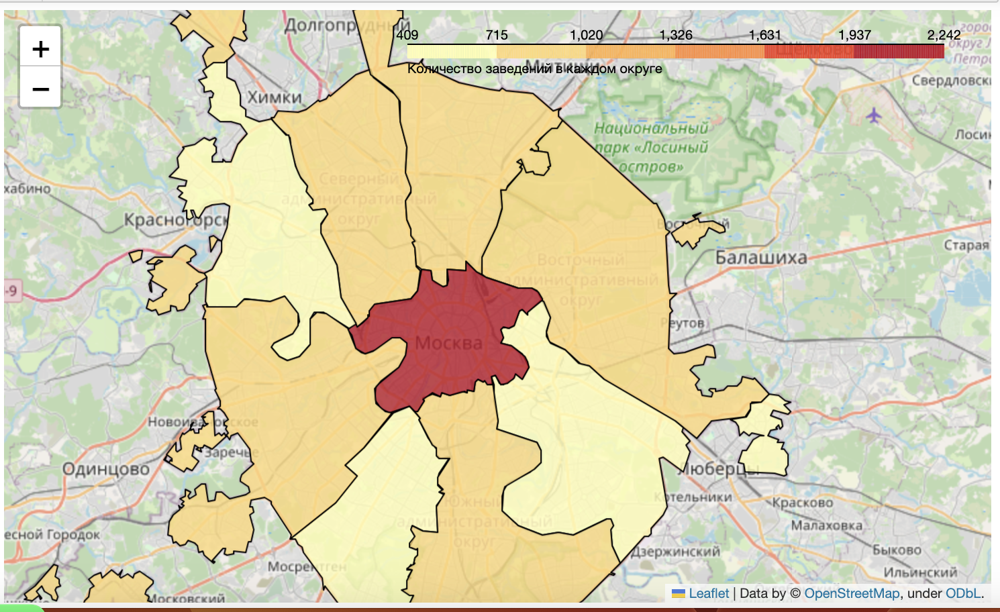

В датасете представлено 9 административных округов Москвы. 

В Центральном округе сконцентрировано больше всего заведений общественного питания: в 2,5 и более раза больше, чем в других округах.
В Северо-Западном округе меньше всего заведений.

Посмотрим на диаграмме распределение заведений по категориям.

In [43]:
# составим сводную таблицу
district_categ = (data
                   .pivot_table(index=['district', 'category'], values='name', aggfunc='count')
                   .sort_values(by=['district', 'category'])
                   .reset_index()
                 )
district_categ

,district,category,name
0,Восточный административный округ,"бар,паб",53
1,Восточный административный округ,булочная,25
2,Восточный административный округ,быстрое питание,71
3,Восточный административный округ,кафе,272
4,Восточный административный округ,кофейня,105
...,...,...,...
67,Южный административный округ,кафе,264
68,Южный административный округ,кофейня,131
69,Южный административный округ,пиццерия,73
70,Южный административный округ,ресторан,202


In [44]:
# диаграмма в разрезе категорий
fig=px.bar(district_categ, x='name', y='district', color='category', text='name')
fig.update_layout(
    title='Распределение заведений по округам в разбивке по категориям', 
    xaxis_title='Количество заведений', 
    yaxis_title='Округ',
    yaxis={'categoryorder': 'total ascending'}
    )
fig.show()

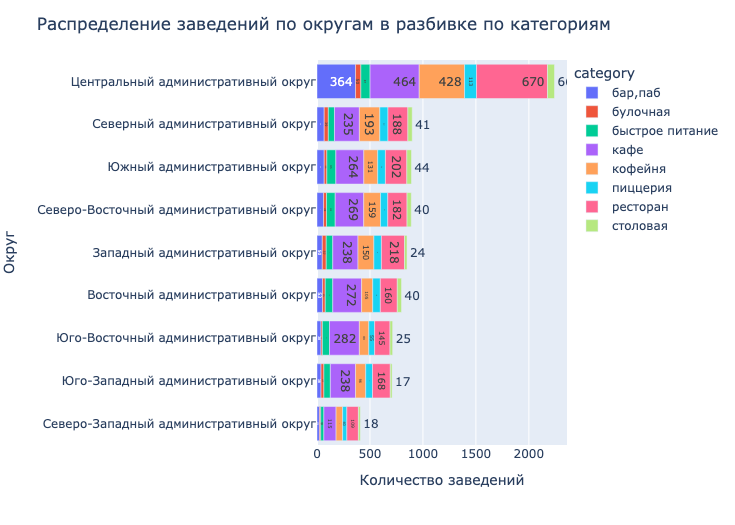

Центральный округ - безусловный лидер по количеству заведений, представлен в первую очередь ресторанами, далее самыми многочисленными являются кафе, кофейни и бары.

В других округах структура схожая, только первое место по количеству занимают уже не рестораны, а кафе, далее идут рестораны и кофейни.

Самым "скромным" на заведения оказался Северо-Западный административный округ, их здесь меньше всего, кафе и ресторанов в нем примерно поровну.

### Средние рейтинги по категориям заведений

Проанализируем рейтинги заведений в разрезе категорий. Сначала посмотрим на распределение значений рейтингов.

In [45]:
# отсортируем категории по убыванию медианы рейтинга для сортировки boxplot
rating_medians = data.groupby('category', as_index=False)['rating']\
.median().sort_values(by='rating', ascending=False)

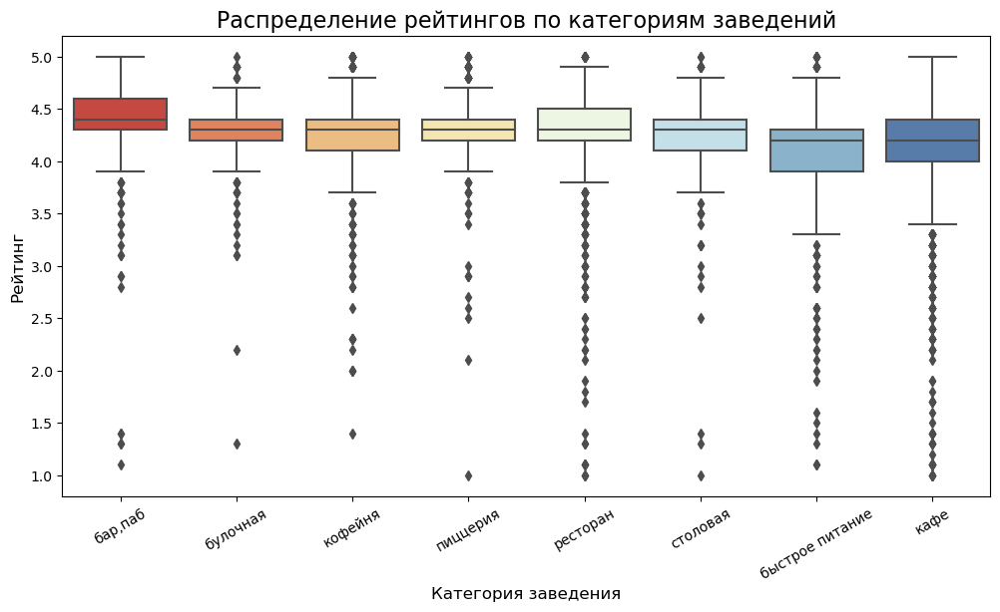

In [46]:
# построим диаграмму размаха
plt.figure(figsize=(12, 6))
sns.boxplot(x='category', y='rating', data=data, order=rating_medians['category'], palette='RdYlBu') 
plt.title('Распределение рейтингов по категориям заведений', size=16)
plt.xticks(rotation=30)
plt.xlabel('Категория заведения', size=12)
plt.ylabel('Рейтинг', size=12);

Сначала отметим, что оценки ниже 3,5 баллов у всех категорий являются редкими случаями и отражаются на диаграмме как выбросы. 

Также оценки в 5 баллов являются нормой только для кафе и баров, для остальных являются редкими случаями.

В основном мы видим, что все категории в большинстве случаев имеют оценки от 4 до 4,5. Можно отметить, что бары и пабы чаще получают более высокие оценки, а заведения быстрого питания наоборот чаще других получают более низкие оценки.

Теперь рассчитаем средние рейтинги и визуализируем сравнение категорий.

In [47]:
# составим сводную таблицу средних рейтингов
rating_categ = data.pivot_table(index='category', values='rating', aggfunc='mean')\
.reset_index()\
.sort_values(by='rating', ascending=False)
rating_categ

,category,rating
0,"бар,паб",4.387696
5,пиццерия,4.301264
6,ресторан,4.290402
4,кофейня,4.277282
1,булочная,4.268359
7,столовая,4.211429
3,кафе,4.123896
2,быстрое питание,4.050249


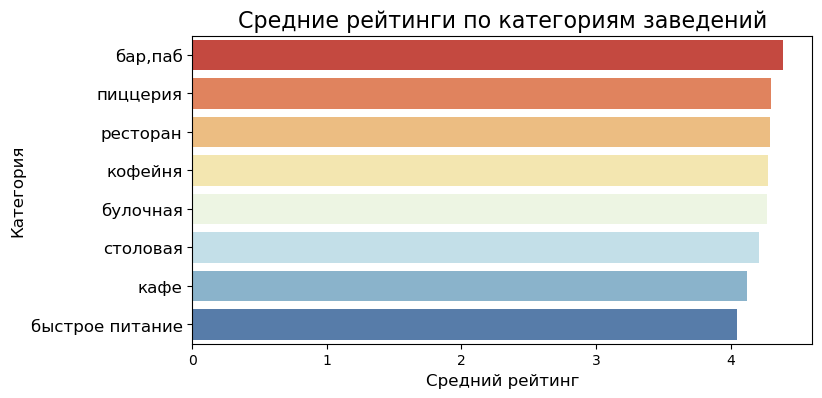

In [48]:
# диаграмма
plt.figure(figsize=(8, 4))
sns.barplot(x='rating', y='category', data=rating_categ, palette='RdYlBu')
plt.title('Средние рейтинги по категориям заведений', size=16)
plt.xticks(size=10)
plt.yticks(size=12)
plt.xlabel( 'Средний рейтинг', size=12)
plt.ylabel('Категория', size=12)
    
plt.show()

Мы видим, что в целом усредненные рейтинги близки по значению, различия минимальны. Самый низкий рейтинг у объектов быстрого питания, самый лучший рейтинг у баров, пабов.

### Фоновая картограмма со средним рейтингом заведений каждого района

Для каждого округа посчитаем средний рейтинг заведений, находящихся в границах округа:

In [49]:
rating_district = data.groupby('district', as_index=False)['rating'].mean()
rating_district

,district,rating
0,Восточный административный округ,4.174185
1,Западный административный округ,4.181647
2,Северный административный округ,4.239822
3,Северо-Восточный административный округ,4.147978
4,Северо-Западный административный округ,4.208802
5,Центральный административный округ,4.377520
6,Юго-Восточный административный округ,4.101120
7,Юго-Западный административный округ,4.172920
8,Южный административный округ,4.184417


Построим фоновую картограмму (хороплет)

In [50]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=rating_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Самый высокий средний рейтинг в Центральном округе, самый низкий в Юго-Восточном округе.

### Карта с кластерами

Отобразим все заведения на карте с помощью кластеров.

In [51]:
# создадим карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создадим пустой кластер, добавим его на карту
marker_cluster = MarkerCluster().add_to(m)

# функция, которая создаёт маркер и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применим функцию к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выведем карту
m

### Топ-15 улиц по количеству заведений

Найдем топ-15 улиц по количеству заведений. Визуализируем распределение по улицам и категориям.

In [52]:
# сводная таблица топ-15
street_top = (data.pivot_table(index='street', values='name', aggfunc='count')
 .sort_values(by='name', ascending=False)
 .reset_index()
 .head(15)
)
street_top

,street,name
0,проспект Мира,183
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


In [53]:
# сводная таблица топ-15 с разбивкой на категории
street_categ = (data[data['street'].isin(street_top['street'])]
                .pivot_table(index=['street', 'category'], values='name', aggfunc='count')
                .sort_values(by=['street', 'category'])
                .reset_index()
)
street_categ = street_categ.rename(columns={'name': 'count'})
street_categ

,street,category,count
0,Варшавское шоссе,"бар,паб",6
1,Варшавское шоссе,быстрое питание,7
2,Варшавское шоссе,кафе,18
3,Варшавское шоссе,кофейня,14
4,Варшавское шоссе,пиццерия,4
...,...,...,...
106,улица Миклухо-Маклая,быстрое питание,4
107,улица Миклухо-Маклая,кафе,21
108,улица Миклухо-Маклая,кофейня,4
109,улица Миклухо-Маклая,пиццерия,2


In [54]:
# построение диаграммы
fig = px.bar (street_categ, x='count', y='street', color='category', text='count')
fig.update_layout(
title='Распределение заведений по категориям на топ-15 улицах',
xaxis_title='Количество заведений', 
yaxis_title='Наименование улицы', 
yaxis={'categoryorder': 'total ascending'})
fig.show()

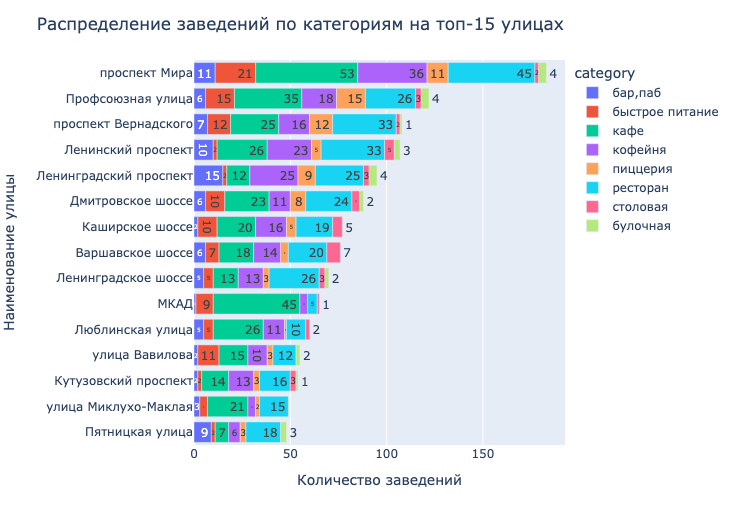

Больше всего заведений насчитывается на длинных улицах Москвы и Мкаде, Проспект Мира при этом заметно вырывается в лидеры. 

Весомыми категориями на всех улицах являются рестораны, кафе и кофейни, рестораны быстрого питания. Бросается в глаза, что на Мкаде почти нет ресторанов, основную часть составляют кафе.

### Улицы с одним заведением

Посмотрим, какие заведения располагаются на улицах с одним объектом.

In [55]:
# список улиц с одним заведением
street_one_object = (data
                    .pivot_table(index='street', values='name', aggfunc='count')
                    .sort_values(by='street')
                    .reset_index()
                    .query('name == 1')

)
street_one_object

,street,name
0,1-й Автозаводский проезд,1
1,1-й Балтийский переулок,1
2,1-й Варшавский проезд,1
3,1-й Вешняковский проезд,1
5,1-й Голутвинский переулок,1
...,...,...
1436,улица Шкулёва,1
1437,улица Шкулёва 4,1
1439,улица Шухова,1
1442,улица Юннатов,1


Нашлось 458 улиц, на которых расположено по одному заведению, определим категории этих заведений:

In [56]:
# категории, к которым относятся заведения
street_one_object_categ = (data[data['street'].isin(street_one_object['street'])]
                           .groupby('category', as_index=False)['name'].agg('count')
                           .sort_values(by='name', ascending=False)
                          )
street_one_object_categ

,category,name
3,кафе,160
6,ресторан,93
4,кофейня,84
0,"бар,паб",39
7,столовая,36
2,быстрое питание,23
5,пиццерия,15
1,булочная,8


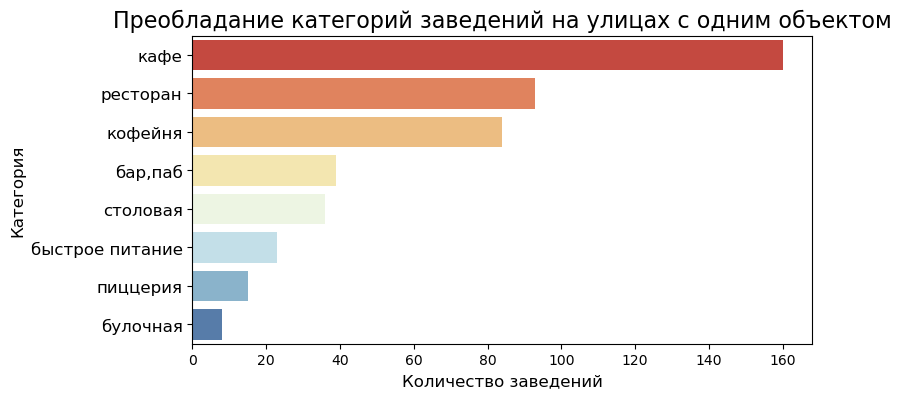

In [57]:
# диаграмма
plt.figure(figsize=(8, 4))
sns.barplot(x='name', y='category', data=street_one_object_categ, palette='RdYlBu')
plt.title('Преобладание категорий заведений на улицах с одним объектом', size=16)
plt.xticks(size=10)
plt.yticks(size=12)
plt.xlabel( 'Количество заведений', size=12)
plt.ylabel('Категория', size=12)
    
plt.show()

На таких улицах чаще всего располагаются кафе, реже рестораны и кофейни. 

Меньше всего на них расположено пиццерий, объектов быстрого питания и булочных.

### Средний чек

Узнаем средний чек по каждому округу города и  отразим данные на карте.

In [58]:
# рассчитаем медианную цену по районам
middle_bill_district = data.pivot_table(index='district', values='middle_avg_bill', aggfunc=('median'))\
.sort_values('middle_avg_bill', ascending=False)\
.reset_index()
middle_bill_district

,district,middle_avg_bill
0,Западный административный округ,1000.0
1,Центральный административный округ,1000.0
2,Северо-Западный административный округ,700.0
3,Северный административный округ,650.0
4,Юго-Западный административный округ,600.0
5,Восточный административный округ,575.0
6,Северо-Восточный административный округ,500.0
7,Южный административный округ,500.0
8,Юго-Восточный административный округ,450.0


In [59]:
# создадим карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создадим хороплет и добавим его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_bill_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Средний счет в заведениях по районам',
).add_to(m)

m

В Центральном и Западном округах Москвы самые высокие цены, самые доступные цены в Северо-Восточном, Южном и Юго-Восточном округах.

### Вывод

**Категория заведений**

Большая часть заведений Москвы позиционирует себя как кафе, далее идут рестораны и кофейни. Меньше всего в городе булочных и столовых.

**Посадочные места**

Почти все заведения имеют до 300 посадочных мест. 

Рестораны, бары, пабы и кофейни в среднем имеют больше всего посадочных мест (от 80 и более).

В среднюю категорию (от 60 до 80 мест) попадают столовые, объекты быстрого питания и кафе.

И узконаправленные заведения, такие как пиццерия и булочные, имеют меньше всего мест (менее 60).

**Принадлежность заведений к сети**

Сетевых заведений 38.1%

Несетевых заведений 61.9%

Несетевых заведений в 1.6 раза больше, чем сетевых. 

В количественном выражении в городе больше всего несетевых кафе и ресторанов.

Если рассматривать каждую категорию, то мы видим, что в большинстве категорий количественно преобладают несетевые заведения над сетевыми. 

Такие категории как кофейни и пиццерии представлены примерно равными долями сетевых/несетевых объектов, а среди булочных наборот преобладают сетевые заведения.

**15 самых популярных сетевых заведений Москвы:**

1. Шоколадница
2. Домино'с Пицца 	
3. Додо Пицца
4. One Price Coffee
5. Яндекс Лавка 	
6. Cofix 	
7. Prime
8. Хинкальная
9. КОФЕПОРТ 	
10. Кулинарная лавка братьев Караваевых
11. Теремок 	
12. Чайхана
13. CofeFest
14. Буханка
15. Му-Му

"Шоколадница" имеет значительно больше заведений в Москве, чем остальные сети. 

Популярные сети представлены преимущественно кофейнями, пиццериями, ресторанами и просто кафе.

70% сетевых заведений, входящих в 15 популярных сетей, не имеют информации о ценовой категории. Но из имеющихся данных большинство заведений представлено в средней ценовой категории.

Тем не менее, отсутствующая часть данных могла бы оказать решающее влияние на выводы о преобладании той или иной ценовой категории в топ-15 сетей. Поэтому мы не можем подтвердить данными свою гипотезу о том, что представленные популярные сети объединены ценовой категорией.

**Распределение заведений по районам Москвы**

В датасете представлено 9 административных округов Москвы. 

В Центральном округе сконцентрировано больше всего заведений общественного питания: в 2,5 и более раза больше, чем в других округах.

Центральный округ представлен в первую очередь ресторанами, далее самыми многочисленными являются кафе, кофейни и бары.

В других округах структура схожая, только первое место по количеству занимают уже не рестораны, а кафе, далее идут рестораны и кофейни.

Самым "скромным" на заведения оказался Северо-Западный административный округ, их здесь меньше всего, кафе и ресторанов в нем примерно поровну.

**Средние рейтинги по категориям заведений**

Оценки ниже 3,5 баллов у всех категорий являются редкими случаями и отражаются на диаграмме как выбросы. 

Также оценки в 5 баллов являются нормой только для кафе и баров, для остальных являются редкими случаями. 

В основном мы видим, что все категории в большинстве случаев имеют оценки от 4 до 4,5. 

Можно отметить, что бары и пабы чаще получают более высокие оценки, а заведения быстрого питания наоборот чаще других получают более низкие оценки.

В целом усредненные рейтинги близки по значению, различия составляют 1-2 десятые доли. 

Самый низкий рейтинг у объектов быстрого питания, самый лучший рейтинг у баров, пабов.

**Средний рейтинг заведений каждого района**

Самый высокий средний рейтинг в Центральном округе, самые низкие в Юго-Восточном округе.

**Топ-15 улиц по количеству заведений**

Больше всего заведений насчитывается на длинных улицах Москвы и Мкаде, Проспект Мира при этом заметно вырывается в лидеры. 

Весомыми категориями на всех улицах являются рестораны, кафе и кофейни, рестораны быстрого питания. Бросается в глаза, что на Мкаде почти нет ресторанов, основную часть составляют кафе.

**Улицы с одним заведением**

Нашлось 458 улиц, на которых расположено по одному заведению.

На таких улицах чаще всего располагаются кафе, реже рестораны и кофейни.

Меньше всего на них расположено пиццерий, объектов быстрого питания и булочных.

**Средний чек**

В Центральном и Западном округах Москвы самые высокие цены.

Самые доступные цены в Северо-Восточном, Южном и Юго-Восточном округах.

## Детализация исследования: открытие кофейни

### Количество кофеен  и их расположение

В связи с поставленной задачей проанализируем рынок кофеен Москвы. Посмотрим, сколько всего кофеен в городе, в каких районах они распологаются, и попробуем выделить особенности их расположения.

In [60]:
# Определим, сколько кофеен в датасете

data_coffee = data.query('category == "кофейня"')
print('В датасете содержится информация о', data_coffee['name'].count(), 'кофеен')

В датасете содержится информация о 1413 кофеен


Составим таблицу с количеством кофеен в каждом районе города и построим фоновую картограмму количества кофеен.

In [61]:
# построение таблицы с количеством кофеен в каждом районе города
data_coffee_district = data_coffee.pivot_table(index='district', values='name', aggfunc='count')\
.sort_values(by='name', ascending=False)\
.reset_index()
data_coffee_district

,district,name
0,Центральный административный округ,428
1,Северный административный округ,193
2,Северо-Восточный административный округ,159
3,Западный административный округ,150
4,Южный административный округ,131
5,Восточный административный округ,105
6,Юго-Западный административный округ,96
7,Юго-Восточный административный округ,89
8,Северо-Западный административный округ,62


In [62]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=data_coffee_district,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Количество кофеен по районам города',
).add_to(m)

# выводим карту
m

Больше всего кофеен в Центральном округе, меньше в Северо-Западном, Юго-Западном  и Юго-Восточном округах.

Нанесем на карту города все кофейни через кластеры и маркеры и выделим особенности их расположения. 

In [63]:
# создадим карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создадим пустой кластер, добавим его на карту
marker_cluster = MarkerCluster().add_to(m)

# функция, которая создаёт маркер и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применим функцию к каждой строке датафрейма
data_coffee.apply(create_clusters, axis=1)

# выведем карту
m

Всего в датасете 1413 кофеен.

Если мы детальнее изучим расположение кофеен на карте, то можно заметить, что больше всего кофеен в Центральном округе, потому что он является центром деловой и туристической активности города, в нем расположено множество исторических объектов, парков, театров, музеев и других объектов притяжения людей, а также множество офисов. Высокая проходимость на улицах центра города стимулирует размещение там кофеен. 

Если говорить о других районах, то преимущественно кофейни располагаются возле или в торговых центрах, бизнес центрах либо на основных улицах движения городского транспорта, что связано с повышенной проходимостью этих мест.

### Наличие круглосуточных кофеен

Проверим, есть ли круглосуточные кофейни в городе. Сначала посмотрим, сколько кофеен с режимом работы "ежедневно, круглосуточно" в количественном и относительном выражении, затем проверим частичный круглосуточный режим кофеен.

In [64]:
# проверка наличия кофеен с режимом работы "ежедневно, круглосуточно"
print('Количество кофеен с ежедневным круглосуточным режимом работы:', \
      data_coffee[data_coffee['is_24/7'] == True]['is_24/7'].count())

Количество кофеен с ежедневным круглосуточным режимом работы: 59


Проверим частичный круглосуточный режим кофеен.

In [65]:
# ищем частичный круглосуточный режим 
data_coffee[data_coffee['hours'].str.contains('круглосуточно')==True]['hours'].unique()

array(['ежедневно, круглосуточно',
       'пн-чт 07:30–23:00; пт 07:30–00:00; сб круглосуточно; вс 00:00–23:00',
       'пн-чт 08:00–23:00; пт,сб круглосуточно; вс 08:00–23:00',
       'пн-ср 07:00–23:00; чт 07:00–00:00; пт,сб круглосуточно; вс 00:00–23:00',
       'пн-чт 08:00–23:00; пт 08:00–00:00; сб круглосуточно; вс 00:00–23:00',
       'пн 08:00–23:00; вт-пт 08:00–00:00; сб круглосуточно; вс 00:00–23:00',
       'пн,вт 08:00–22:00; ср,чт 08:00–23:00; пт,сб круглосуточно; вс 00:00–22:00',
       'пн-чт 07:00–23:00; пт,сб круглосуточно; вс 08:00–23:00',
       'пн-ср 08:00–22:00; чт 08:00–23:00; пт,сб круглосуточно; вс 00:00–22:00',
       'пн-чт 07:00–22:00; пт,сб круглосуточно; вс 00:00–22:00',
       'пн-ср 08:00–23:00; чт 08:00–00:00; пт,сб круглосуточно; вс 00:00–23:00',
       'пн-чт 08:00–22:00; пт 08:00–00:00; сб круглосуточно; вс 00:00–22:00',
       'пн 06:00–00:00; вт-вс круглосуточно',
       'пн-чт 07:00–23:00; пт 07:00–00:00; сб круглосуточно; вс 00:00–23:00'],
      

Мы видим, что есть частичные круглосуточные варианты работы кофеен, в основном по пятницам и субботам. Посчитаем, сколько таких кофеен: 

In [66]:
coffee_24_part = data_coffee[data_coffee['hours'].str.contains('круглосуточно')==True]['name'].count()\
      - data_coffee[data_coffee['is_24/7'] == True]['is_24/7'].count()
print('Количество кофеен с частичным режимом круглосуточной работы:', coffee_24_part
     )

Количество кофеен с частичным режимом круглосуточной работы: 17


Посмотрим, где распологаются кофейни с частичным и полным кругосуточным режимом работы. Для этого нанесем на карту хороплет по районам и отобразим все кофейни на карте.

In [67]:
# создадим таблицу с количеством кофеен с особым режимом в каждом районе 
coffee_24h_district = data_coffee[data_coffee['hours'].str.contains('круглосуточно')==True]\
.groupby('district', as_index=False)['name'].count()\
.sort_values('name', ascending=False)
coffee_24h_district

,district,name
5,Центральный административный округ,38
1,Западный административный округ,11
7,Юго-Западный административный округ,7
2,Северный административный округ,6
0,Восточный административный округ,5
3,Северо-Восточный административный округ,4
4,Северо-Западный административный округ,3
6,Юго-Восточный административный округ,1
8,Южный административный округ,1


In [68]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_24h_district,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.6,
    legend_name=' Кофейни c круглосуточным режимом работы на карте города',
).add_to(m)

# создадим пустой кластер, добавим его на карту
marker_cluster = MarkerCluster().add_to(m)

# функция, которая создаёт маркер и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применим функцию к каждой строке датафрейма
data_coffee[data_coffee['hours'].str.contains('круглосуточно')==True].apply(create_clusters, axis=1)

# выводим карту
m

Мы видим, что такие кофейни сосредоточились прежде всего в центре, где чаще и кипит ночная жизнь города, а также таких заведений больше на западе и юго-западе Москвы.

### Рейтинги кофеен и распределение по районам

Посмотрим, какие рейтинги чаще всего получают кофейни, и как они распределяются по районам.

Посмотрим на частоту оценок рейтингов всех кофеен на графике:

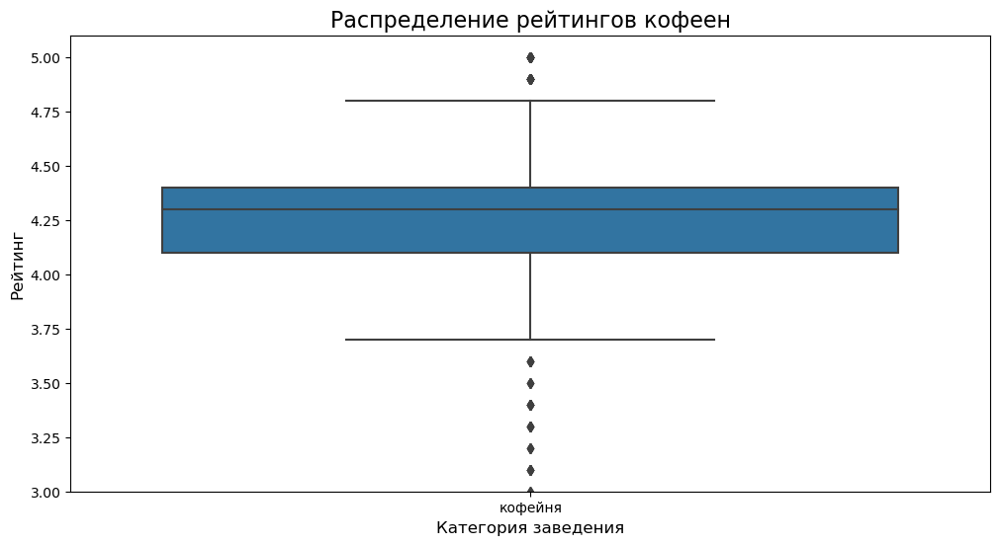

In [69]:
# построим диаграмму размаха
plt.figure(figsize=(12, 6))
sns.boxplot(x='category', y='rating', data=data_coffee) 
plt.title('Распределение рейтингов кофеен', size=16)
plt.xlabel('Категория заведения', size=12)
plt.ylim(3, 5.1)
plt.ylabel('Рейтинг', size=12);

In [70]:
# посмотрим числовое описание диаграммы
data_coffee['rating'].describe()

count    1413.000000
mean        4.277282
std         0.372250
min         1.400000
25%         4.100000
50%         4.300000
75%         4.400000
max         5.000000
Name: rating, dtype: float64

Три четверти кофеен имеют рейтинг до 4.4, средний рейтинг при этом составляет 4.3. Менее одной четверти заведений имеют оценки ниже 4.1, из чего можно сделать вывод, что кофейни редко получают низкие оценки.

Рассчитаем средний рейтинг кофеен для каждого района и отобразим данные на карте.

In [71]:
# Рассчитаем средний рейтинг кофеен для каждого района
coffee_rating_district = (data_coffee
                          .groupby('district', as_index=False)
                          ['rating'].mean())
coffee_rating_district['rating'] = rating_district['rating'].round(1)
coffee_rating_district.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.4
0,Восточный административный округ,4.2
1,Западный административный округ,4.2
2,Северный административный округ,4.2
4,Северо-Западный административный округ,4.2
7,Юго-Западный административный округ,4.2
8,Южный административный округ,4.2
3,Северо-Восточный административный округ,4.1
6,Юго-Восточный административный округ,4.1


In [72]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_rating_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

# выводим карту
m

Как всегда в лидерах по "качеству" заведений Центральный округ, а самые низкие средние рейтинги имеют кофейни в Северо-восточном и Юго-восточном округах.

Посмотрим, есть ли зависимость рейтинга от других характеристик заведения, таких как количество посадочных мест и средняя стоимость чашки капучино. Для этого построим матрицу диаграмм рассеяния.

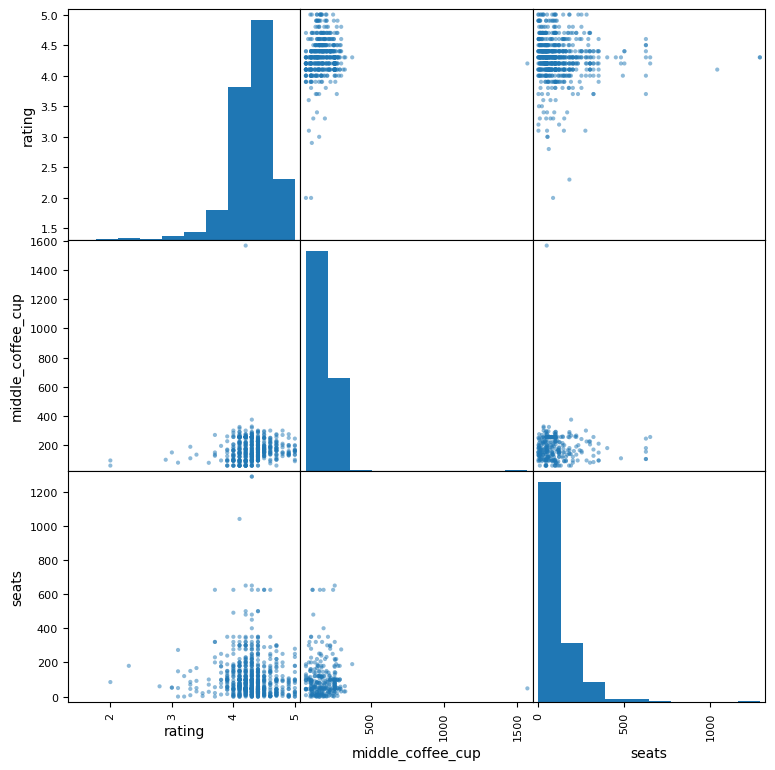

In [73]:
# построим матрицу диаграмм рассеяния
numerical_data = data_coffee[['rating', 'middle_coffee_cup', 'seats']]
pd.plotting.scatter_matrix(numerical_data, figsize=(9, 9))
plt.show()

По матрице мы не видим зависимости рейтинга от этих характеристик объекта. Но также мы знаем, что  у нас только половина известных данных о посадочных местах в кофейнях и лишь треть заполненных данных о стоимости чашки кофе, поэтому, если бы мы имели полные данные, возможно, результат был бы другим.

In [74]:
# количество заполненных строк каждой характеристики кофеен
data_coffee.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1413 entries, 3 to 8397
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1413 non-null   object 
 1   category           1413 non-null   object 
 2   address            1413 non-null   object 
 3   district           1413 non-null   object 
 4   hours              1398 non-null   object 
 5   lat                1413 non-null   float64
 6   lng                1413 non-null   float64
 7   rating             1413 non-null   float64
 8   price              1413 non-null   object 
 9   avg_bill           721 non-null    object 
 10  middle_avg_bill    200 non-null    float64
 11  middle_coffee_cup  521 non-null    float64
 12  chain              1413 non-null   object 
 13  seats              751 non-null    float64
 14  street             1413 non-null   object 
 15  is_24/7            1413 non-null   bool   
dtypes: bool(1), float64(6), 

### Количество посадочных мест кофеен

Проанализируем посадочные места в кофейнях города.

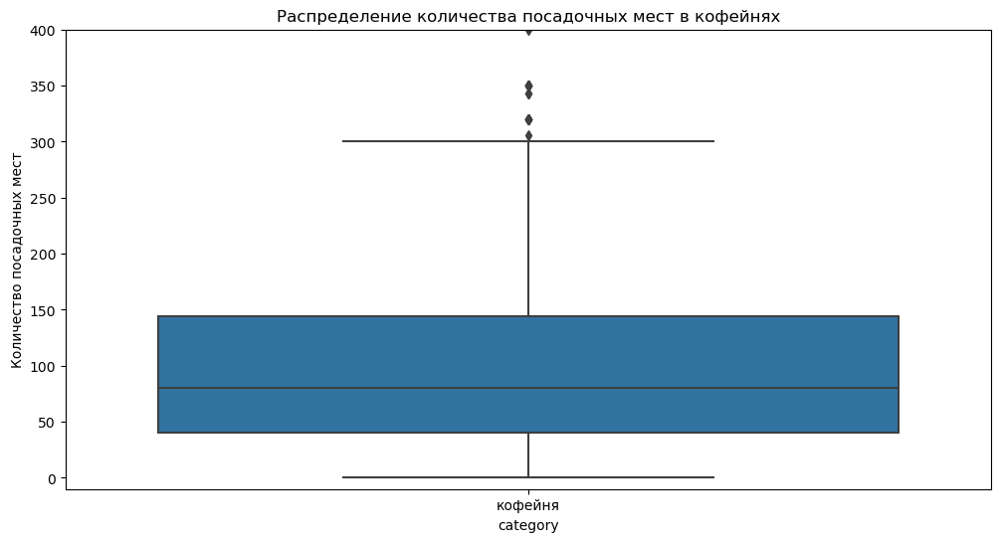

In [75]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='category', y='seats', data=data_coffee) 
plt.ylim(-10, 400)
plt.title('Распределение количества посадочных мест в кофейнях')
plt.ylabel('Количество посадочных мест');

In [76]:
# посмотрим числовое описание диаграммы
data_coffee['seats'].describe()

count     751.000000
mean      111.199734
std       127.837772
min         0.000000
25%        40.000000
50%        80.000000
75%       144.000000
max      1288.000000
Name: seats, dtype: float64

75% кофеен имеет до 144 посадочных мест, при этом среднее количество составляет 80. Лишь четверть кофеен имеет до 40 мест.

### Ориентировочная стоимость чашки капучино

Чтобы дать рекомендацию по ориентировочной стоимости чашки капучино, необходимо проанализировать действующие средние цены на кофе в кофейнях города. 

Для этого построим диаграмму размаха средних цен и сразу уберем на ней выброс в почти 1600 руб за чашку, обозначив параметр ylim = 600 руб.

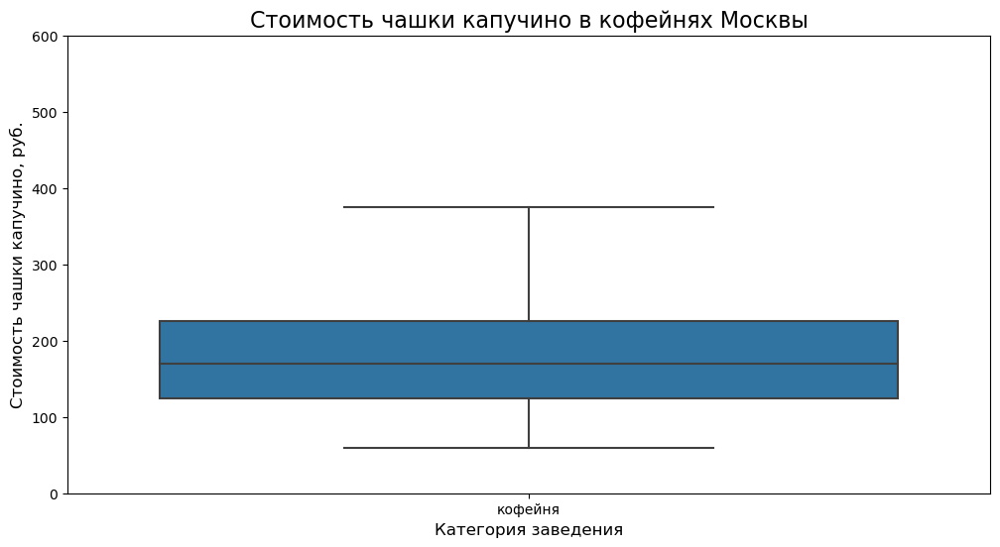

In [77]:
# построим диаграмму размаха
plt.figure(figsize=(12, 6))
sns.boxplot(x='category', y='middle_coffee_cup', data=data_coffee)
plt.ylim(0, 600)
plt.title('Стоимость чашки капучино в кофейнях Москвы', size=16)
plt.xlabel('Категория заведения', size=12)
plt.ylabel('Стоимость чашки капучино, руб.', size=12);

In [78]:
# числовое описание диаграммы
data_coffee['middle_coffee_cup'].describe()

count     521.000000
mean      175.055662
std        89.753009
min        60.000000
25%       124.000000
50%       170.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

Мы видим, что средняя по городу стоимость капучино составляет 170 руб. (медиана и среднее отличаются только в 5 руб.). 75% предложений кофе в целом по городу укладываются в 225 руб.

Я бы рекомендовала ориентироваться на стоимость чашки в зависимости от района расположения новой кофейни. 

Сейчас рассчитаем эту стоимость для каждого района. Возьмем медианную стоимость и стоимость третьего квантиля, потому что считаю, что не стоит при открытии ориентироваться на стоимость ниже средней, либо наоборот высокую.

Рекомендую основателям будущей кофейни при определении стоимости чашки капучино ориентироваться на таблицу ниже, данные в которой представлены в разбивке по районам города. В столбцах указаны:
- средняя стоимость чашки
- стоимость, при которой 75% предложений кофе в данном районе ниже указанной
- средняя стоимость между предыдущими двумя категориями.

Именно цены в последнем столбце я бы рекомендовала использовать для ориентира цены кашки капучино при открытии новой кофейни, считая их конкурентноспособными, не заниженными и не высокими для каждого конкретного района города.

Для наглядности выводов отобразим средние цены на карте и создадим столбчатую диаграмму с рекомендуемыми ценами.

In [79]:
# функция для вычисления третьего квантиля
def quantile_75(column):
    return column.quantile(.75)

# сводная таблица по стоимостям чашки кофе в разбивке по районам
district_coffee_price = (data_coffee.groupby('district', as_index=False)
 .agg(median_coffee_price=('middle_coffee_cup', 'median'),
      quantile_75_coffee_price=('middle_coffee_cup', quantile_75)
     )
)
district_coffee_price['recommend_price'] = \
district_coffee_price[['median_coffee_price', 'quantile_75_coffee_price']].mean(axis=1).round(0)
district_coffee_price = district_coffee_price.sort_values('recommend_price', ascending=False)
district_coffee_price

,district,median_coffee_price,quantile_75_coffee_price,recommend_price
1,Западный административный округ,189.0,256.00,222.0
5,Центральный административный округ,190.0,250.00,220.0
7,Юго-Западный административный округ,198.0,229.25,214.0
2,Северный административный округ,159.0,204.25,182.0
3,Северо-Восточный административный округ,162.5,201.25,182.0
4,Северо-Западный административный округ,165.0,200.00,182.0
8,Южный административный округ,150.0,202.50,176.0
6,Юго-Восточный административный округ,147.5,173.75,161.0
0,Восточный административный округ,135.0,177.50,156.0


Отобразим для наглядности среднюю стоимость чашки капучино по районам:

In [80]:
# создадим карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создадим хороплет и добавим его на карту
Choropleth(
    geo_data=state_geo,
    data=district_coffee_price,
    columns=['district', 'median_coffee_price'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Средняя цена капучино по районам',
).add_to(m)

m

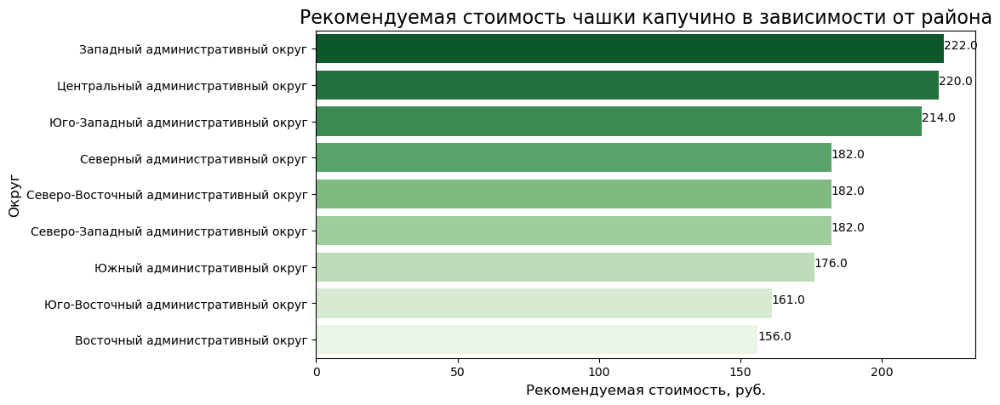

In [81]:
# столбчатая диаграмма с рекомендуемыми ценами
plt.figure(figsize=(10, 5))
sns.barplot(data=district_coffee_price, x='recommend_price', \
           y='district', palette='Greens_r')
plt.title('Рекомендуемая стоимость чашки капучино в зависимости от района', size=16)
plt.xlabel('Рекомендуемая стоимость, руб.', size=12)
plt.ylabel('Округ', size=12)
plt.xticks(size=10)
plt.yticks(size=10)

for index, value in enumerate(district_coffee_price['recommend_price']):
    plt.text(value, index,
             str(value))
plt.show()

## Общий вывод

**ВЫВОД ПО АНАЛИЗУ ВСЕХ ЗАВЕДЕНИЙ**

**Категория заведений**

Всего в данных представлена информация о 8406 заведениях. 

Большая часть заведений Москвы позиционирует себя как кафе, далее идут рестораны и кофейни. Меньше всего в городе булочных и столовых.

**Посадочные места**

Почти все заведения имеют до 300 посадочных мест, а большинство из них (75%) до 150 мест.

Рестораны, бары, пабы и кофейни в среднем имеют больше всего посадочных мест (от 80 и более).

В среднюю категорию (от 60 до 80 мест) попадают столовые, объекты быстрого питания и кафе.

И узконаправленные заведения, такие как пиццерия и булочные, имеют меньше всего мест (менее 60).

**Принадлежность заведений к сети**

Сетевых заведений 38.1%

Несетевых заведений 61.9%

В количественном выражении в городе больше всего несетевых кафе и ресторанов.

Если рассматривать каждую категорию, то мы видим, что в большинстве категорий количественно преобладают несетевые заведения над сетевыми. 

Такие категории как кофейни и пиццерии представлены примерно равными долями сетевых/несетевых объектов, а среди булочных наборот преобладают сетевые заведения.

**15 самых популярных сетевых заведений Москвы:**

1. Шоколадница
2. Домино'с Пицца 	
3. Додо Пицца
4. One Price Coffee
5. Яндекс Лавка 	
6. Cofix 	
7. Prime
8. Хинкальная
9. КОФЕПОРТ 	
10. Кулинарная лавка братьев Караваевых
11. Теремок 	
12. Чайхана
13. CofeFest
14. Буханка
15. Му-Му

"Шоколадница" имеет значительно больше заведений в Москве, чем остальные сети. 

Популярные сети представлены преимущественно кофейнями, пиццериями, ресторанами и просто кафе.

70% сетевых заведений, входящих в 15 популярных сетей, не имеют информации о ценовой категории. Но из имеющихся данных большинство заведений представлено в средней ценовой категории.

Тем не менее, отсутствующая часть данных могла бы оказать решающее влияние на выводы о преобладании той или иной ценовой категории в топ-15 сетей. Поэтому мы не можем подтвердить данными свою гипотезу о том, что представленные популярные сети объединены ценовой категорией.

**Распределение заведений по районам Москвы**

В датасете представлено 9 административных округов Москвы. 

В Центральном округе сконцентрировано больше всего заведений общественного питания: в 2,5 и более раза больше, чем в других округах.

Центральный округ представлен в первую очередь ресторанами, далее самыми многочисленными являются кафе, кофейни и бары.

В других округах структура схожая, только первое место по количеству занимают уже не рестораны, а кафе, далее идут рестораны и кофейни.

Самым "скромным" на заведения оказался Северо-Западный административный округ, их здесь меньше всего, кафе и ресторанов в нем примерно поровну.

**Средние рейтинги по категориям заведений**

Сначала отметим, что оценки ниже 3,5 баллов у всех категорий являются редкими случаями. Также оценки в 5 баллов являются нормой только для кафе и баров, для остальных являются редкими случаями. 

В основном мы видим, что все категории в большинстве случаев имеют оценки от 4 до 4,5. Можно отметить, что бары и пабы чаще получают более высокие оценки, а заведения быстрого питания наоборот чаще других получают более низкие оценки.

В целом усредненные рейтинги близки по значению, различия составляют 1-2 десятые доли. 

Самый низкий рейтинг у объектов быстрого питания, самый лучший рейтинг у баров, пабов.

**Средний рейтинг заведений каждого района**

Самый высокий средний рейтинг в Центральном округе, самые низкие в Северо-Восточном и Юго-Восточном округах.

**Топ-15 улиц по количеству заведений**

Больше всего заведений насчитывается на длинных улицах Москвы и Мкаде, Проспект Мира при этом заметно вырывается в лидеры. 

Весомыми категориями на всех улицах являются рестораны, кафе и кофейни, рестораны быстрого питания. На Мкаде почти нет ресторанов, основную часть составляют кафе.

**Улицы с одним заведением**

Нашлось 458 улиц, на которых расположено по одному заведению.

На таких улицах чаще всего располагаются кафе, реже рестораны и кофейни. 

Меньше всего на них расположено баров, столовых, пиццерий и объектов быстрого питания.

**Средний чек**

В Центральном и Западном округах Москвы самые высокие цены.

Самые доступные цены в Северном, Южном и Юго-восточном округах.

**ВЫВОД ПО АНАЛИЗУ КОФЕЕН**

**Количество кофеен и их расположение**

Всего в датасете 1413 кофеен.

Больше всего кофеен в Центральном округе, потому что он является центром деловой и туристической активности города, в нем расположено множество исторических объектов, парков, театров, музеев и других объектов притяжения людей, а также множество офисов. Высокая проходимость на улицах центра города стимулирует размещение там кофеен.

Если говорить о других районах, то преимущественно кофейни располагаются возле или в торговых центрах, бизнес центрах либо на основных улицах движения городского транспорта, что связано с повышенной проходимостью этих мест.

**Наличие круглосуточных кофеен**

Количество кофеен с ежедневным круглосуточным режимом работы: 59 (4,2%  от всех кофеен)

Количество кофеен с частичным режимом круглосуточной работы (сб/ пт,сб): 17 (1,2% от всех кофеен)

Мы видим, что такие кофейни сосредоточились прежде всего в центре, где чаще и кипит ночная жизнь города, а также таких заведений больше на западе и юго-западе Москвы.

**Рейтинги кофеен и распределение по районам**

Три четверти кофеен имеют рейтинг до 4.4, средний рейтинг при этом составляет 4.3. Менее одной четверти заведений имеют оценки ниже 4.1, из чего можно сделать вывод, что кофейни редко получают низкие оценки.

Как всегда в лидерах по "качеству" заведений Центральный округ, а самые низкие средние рейтинги имеют кофейни в Северо-восточном и Юго-восточном округах.

Зависимость рейтинга от количества посадочных мест и средней стоимости чашки капучино по имеющимся неполным данным не выявлена. 

**Ориентировочная стоимость чашки капучино**

Средняя по городу стоимость капучино составляет 170 руб.

75% предложений кофе в целом по городу укладываются в 225 руб.

Можно при определении цены чашки капучино ориентироваться на таблицу ниже, данные в которой представлены в разбивке по районам города. В столбцах указаны:

    средняя стоимость чашки
    стоимость, при которой 75% предложений кофе в данном районе ниже указанной
    средняя стоимость между предыдущими двумя категориями.

Именно цены в последнем столбце рекомендуем использовать для ориентира цены чашки капучино при открытии новой кофейни, считая их конкурентоспособными, не заниженными и не высокими для каждого конкретного района города.

## Рекомендации

**Район**

Для новой кофейни можно выбрать один из четырех "светлых" на карте районов города (см карту ниже), так как конкуренция в них должна быть ниже, чем в округах с яркой окраской. Либо выбрать другие районы с более яркой окраской, но конкуренция в них будет выше. 
Размещать кофейню в Центральном округе является самым рискованным вариантом, так как концентрация заведений, и кофеен в частности, в этом районе очень высокая, и рейтинги кофеен являются самыми высокими по городу.

In [82]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=data_coffee_district,
    columns=['district', 'name'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Количество кофеен по районам города',
).add_to(m)

# выводим карту
m

In [83]:
# расшифровка к хороплету
data_coffee_district

,district,name
0,Центральный административный округ,428
1,Северный административный округ,193
2,Северо-Восточный административный округ,159
3,Западный административный округ,150
4,Южный административный округ,131
5,Восточный административный округ,105
6,Юго-Западный административный округ,96
7,Юго-Восточный административный округ,89
8,Северо-Западный административный округ,62


**Расположение**

В районах кроме Центрального кофейни обычно располагаются возле или в торговых центрах, бизнес центрах либо на основных улицах движения городского транспорта (вблизи остановок), что связано с повышенной проходимостью этих мест.

**Рейтинги**

Низкие по сравнению с другими районами средние рейтинги имеют кофейни в Северо-восточном и Юго-восточном округах (см карту рейтингов районов ниже). Можно расположить кофейню в одном из этих районов, чтобы составить конкуренцию было проще. 

In [84]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# создаём хороплет и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=coffee_rating_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlOrRd',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

# выводим карту
m

In [85]:
# расшифровка к хороплету
coffee_rating_district.sort_values(by='rating', ascending=False)

,district,rating
5,Центральный административный округ,4.4
0,Восточный административный округ,4.2
1,Западный административный округ,4.2
2,Северный административный округ,4.2
4,Северо-Западный административный округ,4.2
7,Юго-Западный административный округ,4.2
8,Южный административный округ,4.2
3,Северо-Восточный административный округ,4.1
6,Юго-Восточный административный округ,4.1


**Количество посадочных мест**

При выборе помещения можно ориентироваться на следующую информацию:

75% кофеен имеет до 144 посадочных мест, при этом среднее количество составляет 80. 

Лишь четверть кофеен имеет до 40 мест.

**Ориентировочная стоимость чашки капучино**

При определении стоимости чашки капучино можно ориентироваться на таблицу ниже, данные в которой представлены в разбивке по районам города. В столбцах указаны:

* средняя стоимость чашки
* стоимость, при которой 75% предложений кофе в данном районе ниже указанной
* средняя стоимость между предыдущими двумя категориями.

Именно цены в последнем столбце рекомендуем использовать для ориентира цены чашки капучино при открытии новой кофейни, считая их конкурентоспособными, не заниженными и не высокими для каждого конкретного района города.

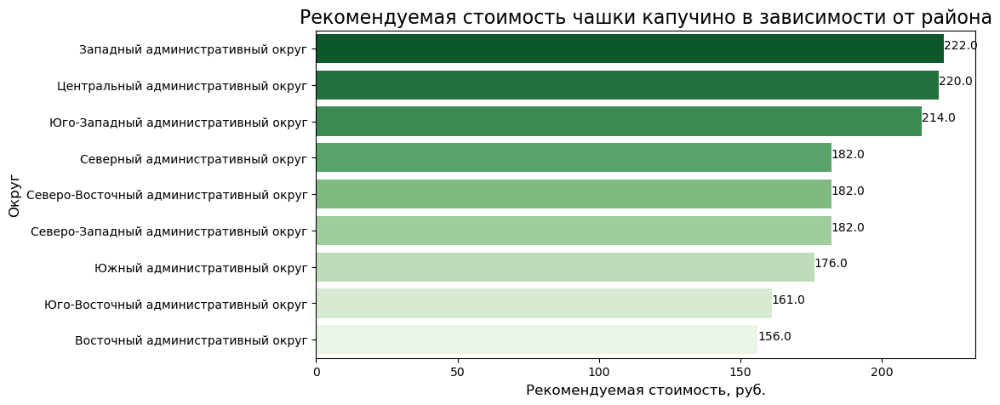

In [86]:
plt.figure(figsize=(10, 5))
sns.barplot(data=district_coffee_price, x='recommend_price', \
           y='district', palette='Greens_r')
plt.title('Рекомендуемая стоимость чашки капучино в зависимости от района', size=16)
plt.xlabel('Рекомендуемая стоимость, руб.', size=12)
plt.ylabel('Округ', size=12)
plt.xticks(size=10)
plt.yticks(size=10)

for index, value in enumerate(district_coffee_price['recommend_price']):
    plt.text(value, index,
             str(value))
plt.show()

In [87]:
# пояснительная таблица с ценами на капучино
district_coffee_price

,district,median_coffee_price,quantile_75_coffee_price,recommend_price
1,Западный административный округ,189.0,256.00,222.0
5,Центральный административный округ,190.0,250.00,220.0
7,Юго-Западный административный округ,198.0,229.25,214.0
2,Северный административный округ,159.0,204.25,182.0
3,Северо-Восточный административный округ,162.5,201.25,182.0
4,Северо-Западный административный округ,165.0,200.00,182.0
8,Южный административный округ,150.0,202.50,176.0
6,Юго-Восточный административный округ,147.5,173.75,161.0
0,Восточный административный округ,135.0,177.50,156.0
